# Investigate RNA-seq attributions for causal variant detection

In [1]:
import h5py 
import numpy as np
import sys
import os

hdf5_path = './data/RNA-seq-preprocessed.hdf5'

with h5py.File(hdf5_path, 'r') as f:
    # List all groups
    for key in f.keys():
        print("Key: %s" % key)
    #data = f[a_group_key][:]
    #print("Data shape: %s" % str(data.shape))

Key: B6_sequence
Key: B_Fo_Sp_IL4.B6
Key: B_Fo_Sp_IL4.CAST
Key: B_Fo_Sp_IL4.ratio
Key: B_Fo_Sp_PBS.B6
Key: B_Fo_Sp_PBS.CAST
Key: B_Fo_Sp_PBS.ratio
Key: Cast_sequence
Key: MF_PC_IL4.B6
Key: MF_PC_IL4.CAST
Key: MF_PC_IL4.ratio
Key: MF_PC_PBS.B6
Key: MF_PC_PBS.CAST
Key: MF_PC_PBS.ratio
Key: MZB_Sp_IL4.B6
Key: MZB_Sp_IL4.CAST
Key: MZB_Sp_IL4.ratio
Key: MZB_Sp_PBS.B6
Key: MZB_Sp_PBS.CAST
Key: MZB_Sp_PBS.ratio
Key: Treg_Sp_IL4.B6
Key: Treg_Sp_IL4.CAST
Key: Treg_Sp_IL4.ratio
Key: Treg_Sp_PBS.B6
Key: Treg_Sp_PBS.CAST
Key: Treg_Sp_PBS.ratio
Key: gene_name
Key: peak_name
Key: sum.B6
Key: sum.CAST
Key: sum.ratio


## Working with DeepAllele tools to predict and check attributions

In [2]:
import os

# Bcell model parameters 
b_mhckpt = 'Bcell/models/mh/init0/model.ckpt'
b_shckpt = 'Bcell/models/sh/init0/model.ckpt'

out_path = os.path.expanduser('~/Git/DeepAllele-public/data/rna/Bcell/results/mh/init0/')
batch_id = 'B_Fo_Sp_IL4'

# MFcell model parameters
#mf_mhckpt = 'MFcell/models/mh/init0/model.ckpt'
#mf_shckpt = 'MFcell/models/sh/init0/model.ckpt'
#out_path = os.path.expanduser('~/Git/DeepAllele-public/data/rna/MFcell/results/mh/init0/')
#batch_id = 'MF_PC_IL4'

split_by_chrom = True
device = 0  # GPU id, -1 for CPU

import numpy as np 
import pandas as pd
import sys
import torch
from DeepAllele import data, tools
import pytorch_lightning as pl
from torch.utils.data import TensorDataset, DataLoader

hdf5_path = './data/RNA-seq-preprocessed.hdf5'
batch_size = 8
num_workers = 4

trainloader, valloader, train_feature, val_feature = data.load_h5(hdf5_path, 
                                                                  split_ratio=0.9,
                                                                  batch_size=batch_size,
                                                                  batch_id=batch_id, 
                                                                  split_by_chrom=split_by_chrom, 
                                                                  shuffle=False,
                                                                  num_workers=num_workers)

# first we need to separate the sequence pairs from the valloader
seqs_all = []
obs_all = []
for bid, (seqs, labels) in enumerate(valloader):
    seqs_all.append(seqs.cpu().numpy())
    obs_all.append(labels.cpu().numpy())
val_seqs = np.concatenate(seqs_all)
print(f'Input sequence shape {np.shape(val_seqs)}')
obs_all = np.concatenate(obs_all)
val_labels = val_feature

print(f'Input observation shape {np.shape(obs_all)}')
obs_df = pd.DataFrame(obs_all, columns=['count_A', 'count_B', 'log_ratio'])

trainer = pl.Trainer(devices=[device] if device>=0 else None, accelerator="gpu" if device>=0  else "cpu", logger=False)

# For multi-head model
mhmodel = tools.load_saved_model(b_mhckpt, 'mh', map_location=f'cuda:{device}' if device>=0 else 'cpu')
res = trainer.predict(mhmodel, valloader)
res=torch.cat(res).numpy()
mh_df = pd.DataFrame()
mh_df['count_A'] = res[:,0]
mh_df['count_B'] = res[:,1]
mh_df['ratioHead'] = res[:,2]
mh_df['ratio_count_A-B'] = res[:,0]-res[:,1]
mh_df['seq_label'] = val_feature

# For single-head model
shmodel = tools.load_saved_model(b_shckpt, 'sh', map_location=f'cuda:{device}' if device>=0 else 'cpu')
placeholder_y = np.zeros((len(val_seqs),1))
dataset_A = TensorDataset(torch.from_numpy(val_seqs[:,:,:,0]), torch.from_numpy(placeholder_y)) # y is placeholder 
dataset_B = TensorDataset(torch.from_numpy(val_seqs[:,:,:,1]), torch.from_numpy(placeholder_y)) # y is placeholder 
loader_A = DataLoader(dataset_A, batch_size=batch_size, shuffle=False, num_workers=num_workers)
loader_B = DataLoader(dataset_B, batch_size=batch_size, shuffle=False, num_workers=num_workers)

res_A = trainer.predict(shmodel, loader_A)
res_B = trainer.predict(shmodel, loader_B)
res_A=torch.cat(res_A).numpy()[:,0,0] # [:,1,0] is obs
res_B=torch.cat(res_B).numpy()[:,0,0] # [:,1,0] is obs

sh_df = pd.DataFrame()
sh_df['count_A'] = res_A
sh_df['count_B'] = res_B
sh_df['ratio_count_A-B'] = res_A -res_B
sh_df['seq_label'] = val_feature


/home/sasse/miniconda3/lib/python3.12/site-packages/Bio/pairwise2.py:278: BiopythonDeprecationWarning: Bio.pairwise2 has been deprecated, and we intend to remove it in a future release of Biopython. As an alternative, please consider using Bio.Align.PairwiseAligner as a replacement, and contact the Biopython developers if you still need the Bio.pairwise2 module.
  warnings.warn(
/home/sasse/miniconda3/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
/home/sasse/miniconda3/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


B_Fo_Sp_IL4
splitting train and val by chrom
splitting finished: using chromosomes ['16', '17', '18'] for validation
there are 5280 samples in val and 49620 samples in train
decode the peak name successfully
splitting train and val by chrom
splitting finished: using chromosomes ['16', '17', '18'] for validation
there are 5280 samples in val and 49620 samples in train
decode the peak name successfully


Using default `ModelCheckpoint`. Consider installing `litmodels` package to enable `LitModelCheckpoint` for automatic upload to the Lightning model registry.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


Input sequence shape (5280, 5100, 4, 2)
Input observation shape (5280, 3)


Lightning automatically upgraded your loaded checkpoint from v1.7.2 to v2.5.1.post0. To apply the upgrade to your files permanently, run `python -m pytorch_lightning.utilities.upgrade_checkpoint Bcell/models/mh/init0/model.ckpt`
You are using a CUDA device ('NVIDIA RTX 2000 Ada Generation Laptop GPU') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
You are using a CUDA device ('NVIDIA RTX 2000 Ada Generation Laptop GPU') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#

Predicting DataLoader 0:   0%|          | 3/660 [00:00<01:37,  6.75it/s]

/home/sasse/miniconda3/lib/python3.12/site-packages/torch/nn/modules/conv.py:370: UserWarning: Using padding='same' with even kernel lengths and odd dilation may require a zero-padded copy of the input be created (Triggered internally at /pytorch/aten/src/ATen/native/Convolution.cpp:1036.)
  return F.conv1d(


Predicting DataLoader 0: 100%|██████████| 660/660 [00:34<00:00, 19.15it/s]


Lightning automatically upgraded your loaded checkpoint from v1.7.2 to v2.5.1.post0. To apply the upgrade to your files permanently, run `python -m pytorch_lightning.utilities.upgrade_checkpoint Bcell/models/sh/init0/model.ckpt`
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 660/660 [00:17<00:00, 38.29it/s]



LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 660/660 [00:17<00:00, 38.33it/s]



0.25226435
(5280, 6) (5280, 3) (5280,)
(5280, 5) (5280, 3) (5280,)


/home/sasse/Git/DeepAllele-public/DeepAllele/plotlib.py:1326: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scat = ax.scatter(x, y, alpha=alpha, s=size, c=color, cmap=cmap, linewidth=lw)


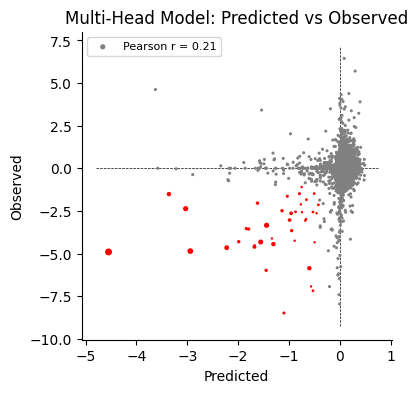

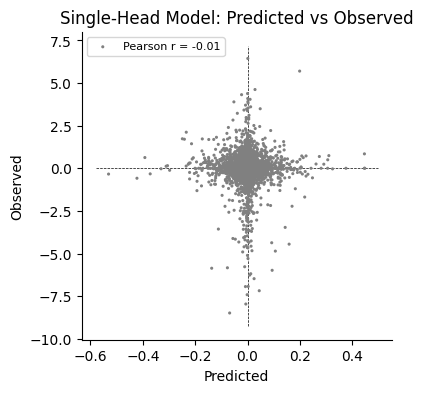

In [ ]:
# Plot predicted versus observed values
from DeepAllele.plotlib import scatter_plot
import numpy as np
import matplotlib.pyplot as plt

# select well predicted sequences
ratio_cut=1.0
predz_cut=1.65
# compute std of predicted values
mh_std = np.sqrt(np.mean(mh_df['ratioHead']**2))
print(mh_std)
#transform to zscores
mh_df['ratioHead_z'] = mh_df['ratioHead']/mh_std
sh_df['ratio_count_A-B_z'] = sh_df['ratio_count_A-B']/mh_std

# select well predicted sequences
# If the indices do not match, pandas will align by index, and the result can be much larger.
# Convert both to NumPy arrays before the operation:
mh_well_pred_mask = (mh_df['ratioHead_z'].values * obs_df['log_ratio'].values > 0)  & (np.abs(mh_df['ratioHead_z'].values) >= predz_cut) & (np.abs(obs_df['log_ratio'].values) >= ratio_cut)
print(mh_df.shape, obs_df.shape, mh_well_pred_mask.shape)
sh_well_pred_mask = (sh_df['ratio_count_A-B_z'].values * obs_df['log_ratio'].values > 0) & (np.abs(sh_df['ratio_count_A-B_z'].values) >= predz_cut) & (np.abs(obs_df['log_ratio'].values) >= ratio_cut)
print(sh_df.shape, obs_df.shape, sh_well_pred_mask.shape)
# create array with grey color for all data points
mh_colors = np.full(mh_df.shape[0], 'grey')
mh_colors[mh_well_pred_mask] = 'red'

sh_colors = np.full(sh_df.shape[0], 'grey')
sh_colors[sh_well_pred_mask] = 'red'

# TODO: create array with sizes all 5, but the ones for significant dots should be scaled by max count of count_A and count_B 
mh_sizes = np.full(mh_df.shape[0], 5)
mh_sizes[mh_well_pred_mask] = 2*2 ** mh_df[['count_A', 'count_B']].values[mh_well_pred_mask].max(axis = 1)
sh_sizes = np.full(sh_df.shape[0], 5)
sh_sizes[sh_well_pred_mask] = 2*2 ** sh_df[['count_A', 'count_B']].values[sh_well_pred_mask].max(axis = 1)

figmh = scatter_plot(mh_df['ratioHead'].values, obs_df['log_ratio'].values, contour = False, color = mh_colors, size = mh_sizes, title='Multi-Head Model: Predicted vs Observed', xlabel='Predicted', ylabel='Observed')
figsh =scatter_plot(sh_df['ratio_count_A-B'], obs_df['log_ratio'], contour = False, color = sh_colors, size = sh_sizes, title='Single-Head Model: Predicted vs Observed', xlabel='Predicted', ylabel='Observed')

figmh.savefig(f'{out_path}{batch_id}mh_pred_vs_obs.png', dpi=100, bbox_inches='tight')
figsh.savefig(f'{out_path}{batch_id}sh_pred_vs_obs.png', dpi=100, bbox_inches='tight')
plt.show()
plt.close(figmh)
plt.close(figsh)

## Create attributions for these

In [16]:
from DeepAllele import model, tools, surrogate_model

def get_surrogate_model(ckpt_path, device = None):
    """
    Captum DeepLift does not allow for reuse of ReLU module, which is part of Deepallele's architecture. 
    To deal with this, we create a surrogate model for interpretation with the same weights as a provided deepallele model, 
    but no resued ReLU. This surrogate model has identical predicton performance to the original. 

    Parameters: 
    - ckpt_path: String path to ckeckpoint containing model paramters for DeepAllele (multi-head) model. 

    Returns: Surrogate model with identical performance to the one found at ckpt_path, but no reuse of ReLU module. 
    """
    # load original model from ckpt 
    if device is not None:
        if isinstance(device, int):
            if device >= 0:
                device = f'cuda:{device}'
            else:
                device = 'cpu'
    orig = model.SeparateMultiHeadResidualCNN.load_from_checkpoint(ckpt_path, map_location=device)
    surrogate = surrogate_model.SeparateMultiHeadResidualCNN_DeepliftSurrogate(
        kernel_number=orig.hparams['kernel_number'],
        kernel_length=orig.hparams['kernel_length'],
        filter_number=orig.hparams['filter_number'],
        kernel_size=orig.hparams['kernel_size'],
        pooling_size=orig.hparams['pooling_size'],
        input_length=orig.hparams['input_length'],
        conv_layers=orig.hparams['conv_layers'],
        hidden_size=orig.hparams['hidden_size'],
    )
    # transfer weights
    surrogate.conv0_b6.load_state_dict(orig.conv0.state_dict())
    for i in range(len(surrogate.convlayers_b6)):
        surrogate.convlayers_b6[i].load_state_dict(orig.convlayers[i].state_dict())

    surrogate.conv0_cast.load_state_dict(orig.conv0.state_dict())
    for i in range(len(surrogate.convlayers_cast)):
        surrogate.convlayers_cast[i].load_state_dict(orig.convlayers[i].state_dict())

    surrogate.fc0_b6.load_state_dict(orig.fc0.state_dict())
    for i in range(len(surrogate.fclayers_b6)):
        surrogate.fclayers_b6[i].load_state_dict(orig.fclayers[i].state_dict())

    surrogate.fc0_cast.load_state_dict(orig.fc0.state_dict())
    for i in range(len(surrogate.fclayers_b6)):
        surrogate.fclayers_cast[i].load_state_dict(orig.fclayers[i].state_dict())

    surrogate.counts_out_b6.load_state_dict(orig.counts_out.state_dict())
    surrogate.counts_out_cast.load_state_dict(orig.counts_out.state_dict())

    surrogate.ratio_out.load_state_dict(orig.ratio_out.state_dict())
    for i in range(len(surrogate.ratio_fclayers)):
        surrogate.ratio_fclayers[i].load_state_dict(orig.ratio_fclayers[i].state_dict())
    surrogate.eval()
    return surrogate

def get_gradient_based_attributions(x, model, baseline,attrib_type='deeplift',target_idx=2,multiply_by_inputs=False,n_steps=50,internal_batch_size=4): 
    """
    Get gradient-based model attributions for a given input sequence and model. 

    Parameters: 
    - x: Tensor model input of shape [batch_size, input length, 4] (4 is for the 4 nucleotides of the one-hot encoded sequence). 
    - model: DeepAllele model (either single-head or multi-head). 
    - baseline: Tensor baseline (only used if attrib_type is 'deeplift' or 'ig'). Baseline should be of the same shape as x: [batch_size, input length, 4]. 
    - attrib_type: String attribution type, of {'deeplift', 'ig', 'grad'}. 
    - target_idx: Integer index of the model output to use for getting attributions. 
    - multiply_by_inputs: Boolean input to DeepLift indicating whether local (if multiply_by_inputs=False) or global (if multiply_by_inputs=True) should be returned. 
    - n_steps: Integer input to IntegratedGradients. 
    - internal_batch_size: Integer input to IntegratedGradients. 

    Returns: Numpy array of attributions of shape [batch_size, input length, 4]. 
    """

    if attrib_type=='deeplift': 
        from captum.attr import DeepLift

        attrib_funct = DeepLift(model.eval(),multiply_by_inputs=multiply_by_inputs)
        attributions = attrib_funct.attribute(x, baseline, target=target_idx, return_convergence_delta=False)
        attributions = attributions.detach().cpu().numpy()

    if attrib_type=='ig': 
        from captum.attr import IntegratedGradients
        ig = IntegratedGradients(model, multiply_by_inputs=multiply_by_inputs)
        attributions = ig.attribute(x,baselines=baseline,return_convergence_delta=False,target=target_idx,n_steps=n_steps,internal_batch_size=internal_batch_size)
        attributions = attributions.detach().cpu().numpy()
    
    if attrib_type=='grad': 
        input_seq = x.clone().requires_grad_(True)
        model_output = model(input_seq)[0]
        model_output[target_idx].backward(retain_graph=True)
        attributions = input_seq.grad.clone().cpu().numpy()
        
    return attributions 

In [44]:
import numpy as np
import torch

torch.cuda.empty_cache()

attribution_type = 'ig' # deeplift ig grad
selected_sequence_labels = val_labels[mh_well_pred_mask]
selected_sequences = val_seqs[mh_well_pred_mask]
selected_obs = obs_all[mh_well_pred_mask]
selected_mhratio = mh_df['ratioHead'].values[mh_well_pred_mask]
selected_mhA = mh_df['count_A'].values[mh_well_pred_mask]
selected_mhB = mh_df['count_B'].values[mh_well_pred_mask]
selected_shratio = sh_df['ratio_count_A-B'].values[mh_well_pred_mask]
device = 0 

# For mh model load check point to surrogate model
mhmodel = get_surrogate_model(b_mhckpt, device=device)
if device>=0:
    mhmodel.to(device)

mh_selected_attributions = np.ones_like(selected_sequences)

for seq_idx in range(selected_sequences.shape[0]):
    print(selected_sequence_labels[seq_idx])
    print('Observed', selected_obs[seq_idx])
    print('Predicted', selected_mhA[seq_idx], selected_mhB[seq_idx], selected_mhratio[seq_idx], 'sh:', selected_shratio[seq_idx])
    curr_seq = selected_sequences[[seq_idx],:,:,:]
    tensor_seq = torch.Tensor(curr_seq)
    # uniform baseline if needed
    baseline = torch.ones_like(tensor_seq)*0.25
    if device>=0: 
        tensor_seq=tensor_seq.to(device)
        baseline=baseline.to(device)
    # check predictions
    mh_pred = mhmodel(tensor_seq)
    mh_pred_baseline = mhmodel(baseline)
    print('Surrogate', mh_pred.detach().cpu().numpy(), mh_pred_baseline.detach().cpu().numpy())
    mh_res = get_gradient_based_attributions(tensor_seq,mhmodel,baseline,target_idx=2,attrib_type=attribution_type)
    mh_res[..., 1] = -mh_res[..., 1]
    mh_selected_attributions[seq_idx,:,:,:] = mh_res
    print(mh_res.shape, tensor_seq.shape, baseline.shape)
    approximated_pred = -np.diff(np.sum(mh_res * (tensor_seq.detach().cpu().numpy()-baseline.detach().cpu().numpy()), axis = (0,1,2)))
    print('Approximated', approximated_pred)




Lightning automatically upgraded your loaded checkpoint from v1.7.2 to v2.5.1.post0. To apply the upgrade to your files permanently, run `python -m pytorch_lightning.utilities.upgrade_checkpoint Bcell/models/mh/init0/model.ckpt`


Amd-ps3-chr18-64448685-64449689
Observed [ 0.     1.642 -1.642]
Predicted 1.3516219 1.3143698 -1.0333933 sh: 0.014285147190093994
Surrogate [[ 1.3516266  1.3143657 -1.0334028]] [[-0.05229124 -0.05229124  0.13976268]]
(1, 5100, 4, 2) torch.Size([1, 5100, 4, 2]) torch.Size([1, 5100, 4, 2])
Approximated [-1.17861222]
Eif3j2-chr18-43475418-43477796
Observed [ 0.     4.658 -4.658]
Predicted 2.6565008 2.6614213 -2.2254417 sh: -0.0004298686981201172
Surrogate [[ 2.656478   2.6614072 -2.22543  ]] [[-0.05229124 -0.05229124  0.13976268]]
(1, 5100, 4, 2) torch.Size([1, 5100, 4, 2]) torch.Size([1, 5100, 4, 2])
Approximated [-2.40612604]
Eif3s6-ps2-chr18-90310868-90312190
Observed [ 3.079  7.611 -4.532]
Predicted 1.0210216 1.2143402 -1.6769465 sh: -0.004893839359283447
Surrogate [[ 1.0210164  1.2143333 -1.6769454]] [[-0.05229124 -0.05229124  0.13976268]]
(1, 5100, 4, 2) torch.Size([1, 5100, 4, 2]) torch.Size([1, 5100, 4, 2])
Approximated [-1.84585775]
Gm10036-chr18-15832794-15833327
Observed [ 4.81

In [24]:
torch.cuda.empty_cache()
# For sh model
shmodel = tools.load_saved_model(b_shckpt, 'sh', map_location=f'cuda:{device}' if device>=0 else 'cpu')
if device>=0:
    shmodel.to(device)

sh_selected_attributions = np.ones_like(selected_sequences)
for seq_idx in range(selected_sequences.shape[0]):
    curr_seq = selected_sequences[[seq_idx],:,:,:]
    tensor_seq = torch.Tensor(curr_seq)
    # uniform baseline if needed
    baseline = torch.ones_like(tensor_seq)*0.25
    if device>=0: 
        tensor_seq=tensor_seq.to(device)
        baseline=baseline.to(device)
    res_0 = get_gradient_based_attributions(tensor_seq[:,:,:,0],shmodel,baseline[:,:,:,0],target_idx=0,attrib_type=attribution_type)
    res_1 = get_gradient_based_attributions(tensor_seq[:,:,:,1],shmodel,baseline[:,:,:,1],target_idx=0,attrib_type=attribution_type)
    sh_selected_attributions[seq_idx,:,:,0] = res_0
    sh_selected_attributions[seq_idx,:,:,1] = res_1

Lightning automatically upgraded your loaded checkpoint from v1.7.2 to v2.5.1.post0. To apply the upgrade to your files permanently, run `python -m pytorch_lightning.utilities.upgrade_checkpoint Bcell/models/sh/init0/model.ckpt`


Amd-ps3-chr18-64448685-64449689 [-0.4662405   0.51644033]
Ylim [np.float64(-0.0027665046509355307), np.float64(0.0030255464371293783)]
Ylim [np.float64(-0.0027665046509355307), np.float64(0.0030255464371293783)]


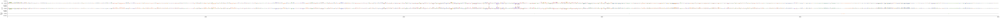

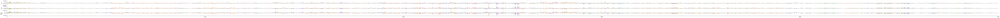

Amd-ps3-chr18-64448685-64449689mh_ig_B_Fo_Sp_IL4.jpg
Eif3j2-chr18-43475418-43477796 [-0.915976   1.0160517]
Ylim [np.float64(-0.004678367171436548), np.float64(0.00588567741215229)]
Ylim [np.float64(-0.004678367171436548), np.float64(0.00588567741215229)]


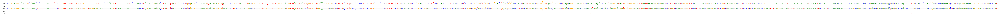

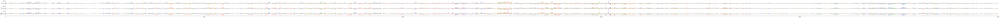

Eif3j2-chr18-43475418-43477796mh_ig_B_Fo_Sp_IL4.jpg
Eif3s6-ps2-chr18-90310868-90312190 [-0.7845293   0.82092994]
Ylim [np.float64(-0.015807580202817917), np.float64(0.01605149358510971)]
Ylim [np.float64(-0.015807580202817917), np.float64(0.01605149358510971)]


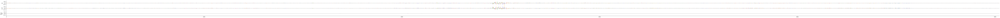

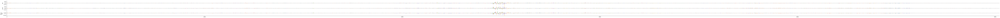

Eif3s6-ps2-chr18-90310868-90312190mh_ig_B_Fo_Sp_IL4.jpg
Gm10036-chr18-15832794-15833327 [-0.3772836   0.41608444]
Ylim [np.float64(-0.00415473897010088), np.float64(0.006035373546183109)]
Ylim [np.float64(-0.00415473897010088), np.float64(0.006035373546183109)]


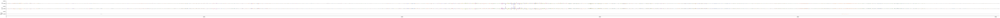

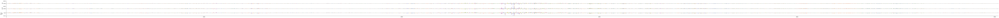

Gm10036-chr18-15832794-15833327mh_ig_B_Fo_Sp_IL4.jpg
Gm10074-chr17-36226023-36226271 [-0.36895844  0.45160782]
Ylim [np.float64(-0.01234816387295723), np.float64(0.014285074546933174)]
Ylim [np.float64(-0.01234816387295723), np.float64(0.014285074546933174)]


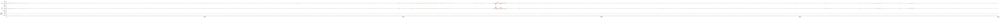

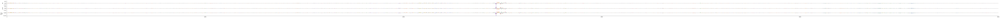

Gm10074-chr17-36226023-36226271mh_ig_B_Fo_Sp_IL4.jpg
Gm10232-chr17-3044014-3044733 [-1.2187705  1.248239 ]
Ylim [np.float64(-0.007183243986219168), np.float64(0.006775630172342062)]
Ylim [np.float64(-0.007183243986219168), np.float64(0.006775630172342062)]


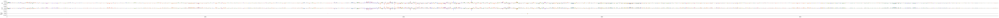

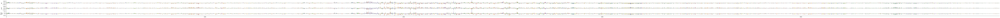

Gm10232-chr17-3044014-3044733mh_ig_B_Fo_Sp_IL4.jpg
Gm10241-chr16-20176727-20177012 [-0.6527141  0.7084068]
Ylim [np.float64(-0.003696697298437357), np.float64(0.004266353324055672)]
Ylim [np.float64(-0.003696697298437357), np.float64(0.004266353324055672)]


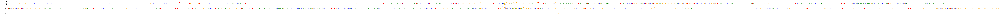

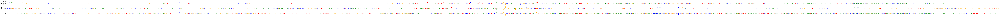

Gm10241-chr16-20176727-20177012mh_ig_B_Fo_Sp_IL4.jpg
Gm10269-chr18-20682594-20682963 [-0.61886936  0.71718955]
Ylim [np.float64(-0.004198660608381033), np.float64(0.00440094992518425)]
Ylim [np.float64(-0.004198660608381033), np.float64(0.00440094992518425)]


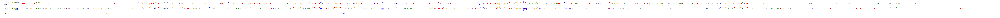

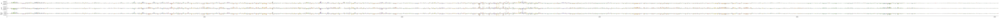

Gm10269-chr18-20682594-20682963mh_ig_B_Fo_Sp_IL4.jpg
Gm19807-chr17-37130909-37131575 [-0.36381868  0.38981965]
Ylim [np.float64(-0.003384010400623083), np.float64(0.004186227917671204)]
Ylim [np.float64(-0.003384010400623083), np.float64(0.004186227917671204)]


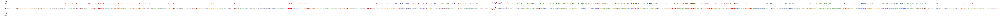

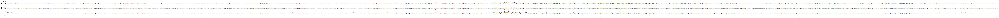

Gm19807-chr17-37130909-37131575mh_ig_B_Fo_Sp_IL4.jpg
Gm20056-chr16-32408536-32409054 [-0.3862484   0.42193052]
Ylim [np.float64(-0.0034516004379838705), np.float64(0.0038197801914066076)]
Ylim [np.float64(-0.0034516004379838705), np.float64(0.0038197801914066076)]


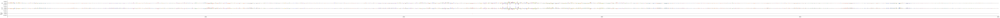

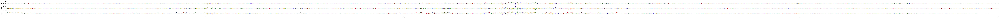

Gm20056-chr16-32408536-32409054mh_ig_B_Fo_Sp_IL4.jpg
Gm3815-chr18-51003104-51003605 [-0.39206922  0.43322408]
Ylim [np.float64(-0.012254798784852028), np.float64(0.013279823586344719)]


/home/sasse/miniconda3/lib/python3.12/site-packages/logomaker/src/Logo.py:1001: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  self.ax.set_ylim([ymin, ymax])


Ylim [np.float64(-0.012254798784852028), np.float64(0.013279823586344719)]


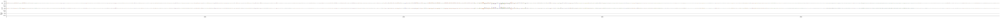

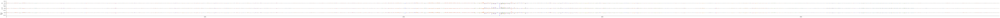

Gm3815-chr18-51003104-51003605mh_ig_B_Fo_Sp_IL4.jpg
Gm4600-chr16-37696770-37697340 [-0.28387257  0.3041756 ]
Ylim [np.float64(-0.0027474171947687864), np.float64(0.0031311670318245888)]
Ylim [np.float64(-0.0027474171947687864), np.float64(0.0031311670318245888)]


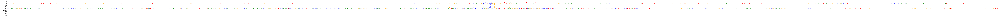

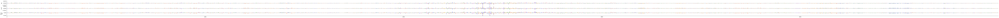

Gm4600-chr16-37696770-37697340mh_ig_B_Fo_Sp_IL4.jpg
Gm4737-chr16-46152985-46155077 [-1.2146856  1.256113 ]
Ylim [np.float64(-0.021848559379577637), np.float64(0.028480855748057365)]
Ylim [np.float64(-0.021848559379577637), np.float64(0.028480855748057365)]


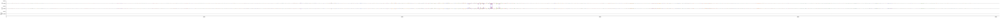

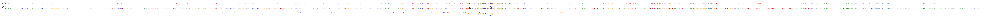

Gm4737-chr16-46152985-46155077mh_ig_B_Fo_Sp_IL4.jpg
Gm4766-chr17-45163230-45164168 [-0.469179   0.5129639]
Ylim [np.float64(-0.005425106268376112), np.float64(0.0058656977489590645)]
Ylim [np.float64(-0.005425106268376112), np.float64(0.0058656977489590645)]


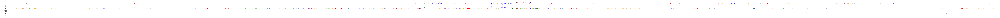

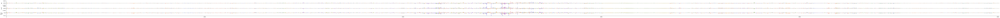

Gm4766-chr17-45163230-45164168mh_ig_B_Fo_Sp_IL4.jpg
Gm5487-chr16-53983928-53986084 [-0.6752928  0.7258332]
Ylim [np.float64(-0.007427579257637262), np.float64(0.007734654936939478)]
Ylim [np.float64(-0.007427579257637262), np.float64(0.007734654936939478)]


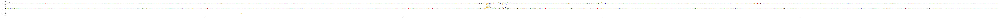

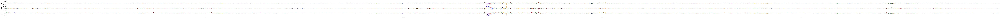

Gm5487-chr16-53983928-53986084mh_ig_B_Fo_Sp_IL4.jpg
Gm5503-chr18-33384398-33384955 [-0.76975715  0.83816445]
Ylim [np.float64(-0.01036529615521431), np.float64(0.011724325828254223)]
Ylim [np.float64(-0.01036529615521431), np.float64(0.011724325828254223)]


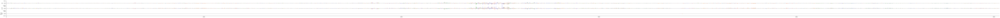

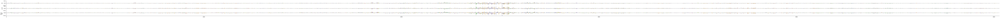

Gm5503-chr18-33384398-33384955mh_ig_B_Fo_Sp_IL4.jpg
Gm5824-chr18-85847280-85848729 [-0.4179095   0.49533406]
Ylim [np.float64(-0.007693137042224407), np.float64(0.008321833796799183)]
Ylim [np.float64(-0.007693137042224407), np.float64(0.008321833796799183)]


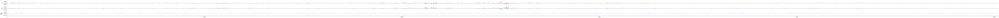

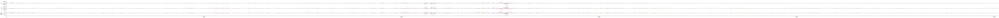

Gm5824-chr18-85847280-85848729mh_ig_B_Fo_Sp_IL4.jpg
Gm6440-chr16-17137328-17137681 [-0.3157045   0.32326835]
Ylim [np.float64(-0.0028737017419189215), np.float64(0.0034591234289109707)]
Ylim [np.float64(-0.0028737017419189215), np.float64(0.0034591234289109707)]


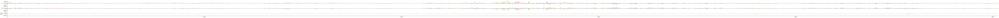

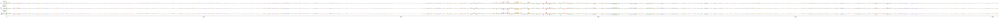

Gm6440-chr16-17137328-17137681mh_ig_B_Fo_Sp_IL4.jpg
Gm6457-chr18-14570147-14570638 [-0.54649144  0.62263113]
Ylim [np.float64(-0.005188571754842997), np.float64(0.006529104895889759)]
Ylim [np.float64(-0.005188571754842997), np.float64(0.006529104895889759)]


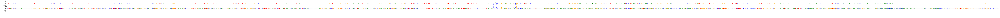

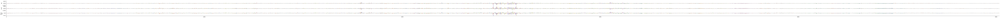

Gm6457-chr18-14570147-14570638mh_ig_B_Fo_Sp_IL4.jpg
Gm6475-chr17-3312250-3314185 [-0.23837113  0.264535  ]
Ylim [np.float64(-0.0010671063791960478), np.float64(0.0013275122037157416)]
Ylim [np.float64(-0.0010671063791960478), np.float64(0.0013275122037157416)]


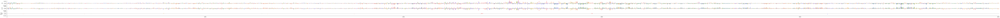

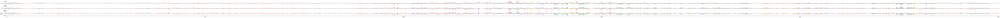

Gm6475-chr17-3312250-3314185mh_ig_B_Fo_Sp_IL4.jpg
Gm6552-chr17-79933512-79934572 [-0.76328975  0.8974473 ]
Ylim [np.float64(-0.01028638519346714), np.float64(0.011559762991964817)]
Ylim [np.float64(-0.01028638519346714), np.float64(0.011559762991964817)]


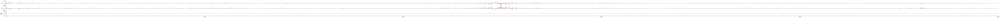

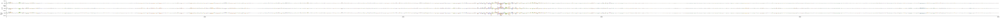

Gm6552-chr17-79933512-79934572mh_ig_B_Fo_Sp_IL4.jpg
Gm6623-chr17-36179114-36179657 [-0.2590774   0.29092097]
Ylim [np.float64(-0.0014865510165691376), np.float64(0.001798503682948649)]


/home/sasse/miniconda3/lib/python3.12/site-packages/logomaker/src/Logo.py:1001: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  self.ax.set_ylim([ymin, ymax])


Ylim [np.float64(-0.0014865510165691376), np.float64(0.001798503682948649)]


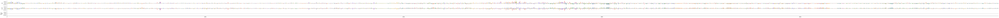

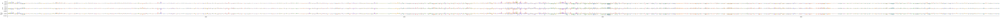

Gm6623-chr17-36179114-36179657mh_ig_B_Fo_Sp_IL4.jpg
Gm6767-chr16-51362452-51363832 [-0.46946162  0.51012456]
Ylim [np.float64(-0.004270905163139105), np.float64(0.005185172893106937)]
Ylim [np.float64(-0.004270905163139105), np.float64(0.005185172893106937)]


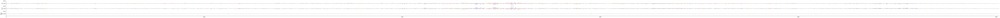

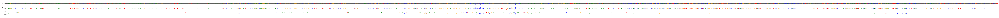

Gm6767-chr16-51362452-51363832mh_ig_B_Fo_Sp_IL4.jpg
Gm6960-chr18-60426292-60426934 [-0.36154628  0.43474182]
Ylim [np.float64(-0.010389016941189766), np.float64(0.010969258844852448)]
Ylim [np.float64(-0.010389016941189766), np.float64(0.010969258844852448)]


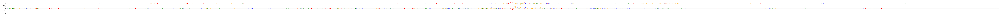

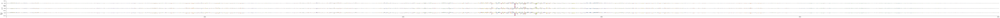

Gm6960-chr18-60426292-60426934mh_ig_B_Fo_Sp_IL4.jpg
Gm6978-chr18-64611725-64612440 [-1.7854207  1.8427188]
Ylim [np.float64(-0.009483639150857925), np.float64(0.01118524745106697)]
Ylim [np.float64(-0.009483639150857925), np.float64(0.01118524745106697)]


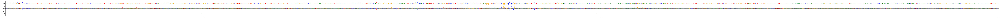

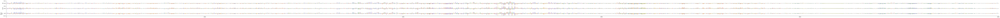

Gm6978-chr18-64611725-64612440mh_ig_B_Fo_Sp_IL4.jpg
Gm7334-chr17-50698688-50699443 [-1.3072718  1.3972206]
Ylim [np.float64(-0.0065670618787407875), np.float64(0.008683012798428535)]
Ylim [np.float64(-0.0065670618787407875), np.float64(0.008683012798428535)]


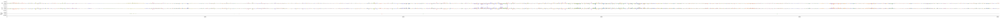

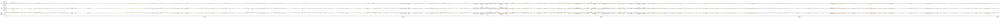

Gm7334-chr17-50698688-50699443mh_ig_B_Fo_Sp_IL4.jpg
Gm7535-chr17-17911040-17912816 [-0.583641    0.58517283]
Ylim [np.float64(-0.006719579454511404), np.float64(0.006732201669365168)]
Ylim [np.float64(-0.006719579454511404), np.float64(0.006732201669365168)]


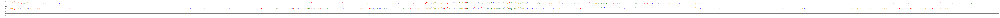

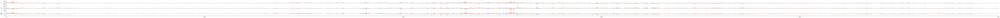

Gm7535-chr17-17911040-17912816mh_ig_B_Fo_Sp_IL4.jpg
Gm7623-chr18-86242965-86243520 [-0.43311566  0.4859094 ]
Ylim [np.float64(-0.0034161037765443325), np.float64(0.0038157356902956963)]
Ylim [np.float64(-0.0034161037765443325), np.float64(0.0038157356902956963)]


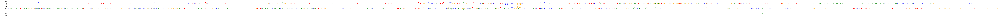

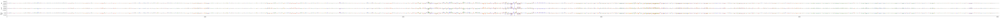

Gm7623-chr18-86242965-86243520mh_ig_B_Fo_Sp_IL4.jpg
Gm8181-chr18-43171159-43171824 [-0.56120586  0.6149225 ]
Ylim [np.float64(-0.004051416181027889), np.float64(0.00712047191336751)]
Ylim [np.float64(-0.004051416181027889), np.float64(0.00712047191336751)]


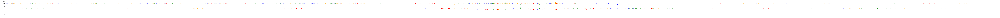

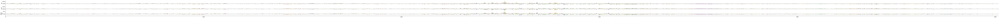

Gm8181-chr18-43171159-43171824mh_ig_B_Fo_Sp_IL4.jpg
Gm8731-chr18-60778983-60779394 [-0.76758325  0.8015887 ]
Ylim [np.float64(-0.01108916848897934), np.float64(0.014175547286868095)]
Ylim [np.float64(-0.01108916848897934), np.float64(0.014175547286868095)]


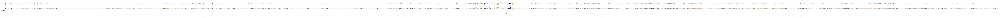

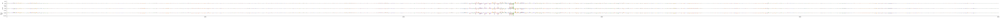

Gm8731-chr18-60778983-60779394mh_ig_B_Fo_Sp_IL4.jpg
Gm9214-chr17-53359927-53361889 [-0.25792342  0.27377525]
Ylim [np.float64(-0.0019076813478022814), np.float64(0.002016355050727725)]
Ylim [np.float64(-0.0019076813478022814), np.float64(0.002016355050727725)]


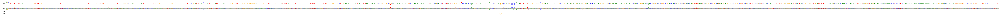

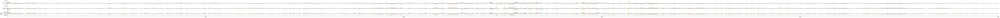

Gm9214-chr17-53359927-53361889mh_ig_B_Fo_Sp_IL4.jpg
Gm9416-chr17-94608185-94608497 [-0.23084447  0.27272967]
Ylim [np.float64(-0.00100524234585464), np.float64(0.0011410883162170649)]
Ylim [np.float64(-0.00100524234585464), np.float64(0.0011410883162170649)]


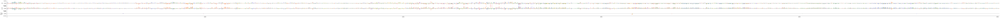

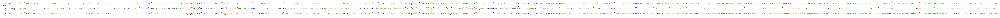

Gm9416-chr17-94608185-94608497mh_ig_B_Fo_Sp_IL4.jpg
Gm9514-chr17-22184764-22186108 [-0.8349458   0.86455166]
Ylim [np.float64(-0.006282999645918608), np.float64(0.006785351317375898)]
Ylim [np.float64(-0.006282999645918608), np.float64(0.006785351317375898)]


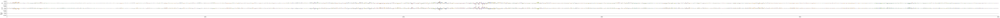

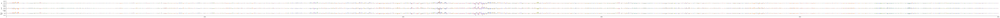

Gm9514-chr17-22184764-22186108mh_ig_B_Fo_Sp_IL4.jpg
Gm9843-chr16-76403251-76403652 [-0.31228843  0.3437806 ]
Ylim [np.float64(-0.004916689824312925), np.float64(0.005635185167193413)]
Ylim [np.float64(-0.004916689824312925), np.float64(0.005635185167193413)]


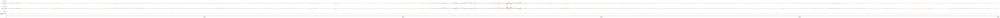

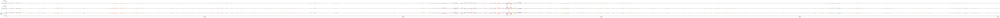

Gm9843-chr16-76403251-76403652mh_ig_B_Fo_Sp_IL4.jpg
Gng5-ps-chr16-22295027-22295231 [-0.6923472   0.69597715]
Ylim [np.float64(-0.0076508549973368645), np.float64(0.009277445264160633)]
Ylim [np.float64(-0.0076508549973368645), np.float64(0.009277445264160633)]


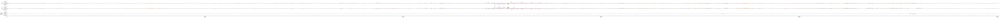

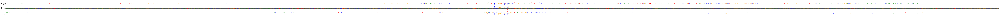

Gng5-ps-chr16-22295027-22295231mh_ig_B_Fo_Sp_IL4.jpg
Hdac1-ps-chr17-78491582-78493025 [-0.29950655  0.36445093]
Ylim [np.float64(-0.004434217698872089), np.float64(0.0043451013043522835)]
Ylim [np.float64(-0.004434217698872089), np.float64(0.0043451013043522835)]


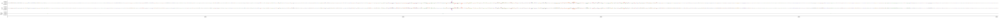

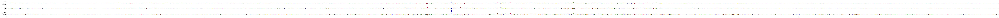

Hdac1-ps-chr17-78491582-78493025mh_ig_B_Fo_Sp_IL4.jpg
Ndufs5-ps-chr16-42955631-42955949 [-0.42209485  0.45785508]
Ylim [np.float64(-0.002668137662112713), np.float64(0.0024252613075077534)]
Ylim [np.float64(-0.002668137662112713), np.float64(0.0024252613075077534)]


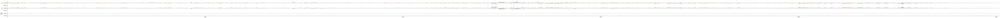

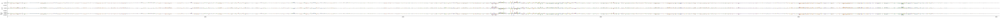

Ndufs5-ps-chr16-42955631-42955949mh_ig_B_Fo_Sp_IL4.jpg
Oaz1-ps-chr17-17345456-17346140 [-0.48955253  0.5094393 ]
Ylim [np.float64(-0.00471541378647089), np.float64(0.005913828499615192)]
Ylim [np.float64(-0.00471541378647089), np.float64(0.005913828499615192)]


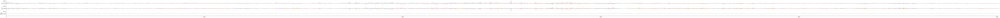

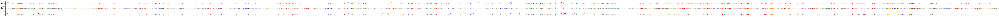

Oaz1-ps-chr17-17345456-17346140mh_ig_B_Fo_Sp_IL4.jpg
Rbx1-ps-chr17-35935624-35935950 [-0.2665743   0.32171062]
Ylim [np.float64(-0.002028830349445343), np.float64(0.0021526729688048363)]
Ylim [np.float64(-0.002028830349445343), np.float64(0.0021526729688048363)]


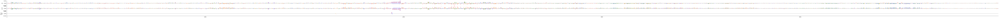

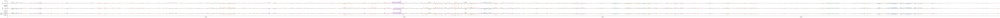

Rbx1-ps-chr17-35935624-35935950mh_ig_B_Fo_Sp_IL4.jpg
Rpl27-ps3-chr18-6332632-6333042 [-0.39020178  0.4341315 ]
Ylim [np.float64(-0.0048591215163469315), np.float64(0.005317519418895245)]
Ylim [np.float64(-0.0048591215163469315), np.float64(0.005317519418895245)]


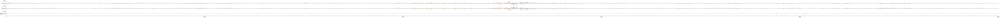

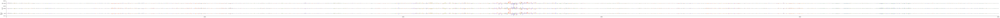

Rpl27-ps3-chr18-6332632-6333042mh_ig_B_Fo_Sp_IL4.jpg


In [45]:
from DeepAllele.plotlib import plot_attribution
import matplotlib.pyplot as plt


unit=0.04
height_scale = 25
ylim = None
outname = f'mh_{attribution_type}_{batch_id}'
dpi = 200
fmt = 'jpg'

for seq_idx in range(selected_sequences.shape[0]):
    sel_att = mh_selected_attributions[seq_idx]
    sel_seq = selected_sequences[seq_idx]
    
    print(selected_sequence_labels[seq_idx], np.sum(sel_att*sel_seq, axis=(0,1)))
    
    # normalize along the base axis
    sel_att = sel_att - np.mean(sel_att, axis = -2, keepdims=True)

    fig = plot_attribution(sel_seq, sel_att, plot_effect_difference = True, plot_difference = True,
                           seq_based = True, xticks = None, xticklabels = None, ylim = None, 
                           unit = unit, height_scale = height_scale)

    figdiff = plot_attribution(sel_seq, sel_att, plot_effect_difference = False, plot_difference = True,
                           seq_based = True, xticks = None, xticklabels = None, ylim = None, 
                           unit = unit, height_scale = height_scale)
    
    plt.show()
    fig.savefig(out_path+selected_sequence_labels[seq_idx]+outname+'.'+fmt, dpi = dpi, bbox_inches = 'tight')
    figdiff.savefig(out_path+selected_sequence_labels[seq_idx]+outname+'.diff.'+fmt, dpi = dpi, bbox_inches = 'tight')
    print(selected_sequence_labels[seq_idx]+outname+'.'+fmt)
    
    plt.close(fig)